<a href="https://colab.research.google.com/github/hubeidata/semaforo_nutricional/blob/Task_Tayra/capturando_imagenes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

este se utiliza para generar imagenes de platos


In [ ]:
#Generador de imagenes

import cv2
import os
import imutils

objectName ='Ceviche_peruano'
dataPath = '/content/drive/MyDrive/semaforo'
personPath = dataPath + '/' + objectName
print(personPath)
if not os.path.exists(personPath):

    os.makedirs(personPath)
    if not os.path.exists(personPath):
        print('Error al crear la carpeta')
    else:
        print('Carpeta creada')
else:
    print("Ya existe esta carpeta")

cap = cv2.VideoCapture('/content/drive/MyDrive/semaforo/videos/Ceviche_peruano.mp4')
count = 0
while True:
    ret, frame = cap.read()
    if ret == False: break
    frame = imutils.resize(frame, width=640)
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    auxFrame = frame.copy()

    objecto = cv2.resize(auxFrame,(150,150),interpolation=cv2.INTER_CUBIC)
    cv2.imwrite(personPath + '/'+ objectName +'_{}.jpg'.format(count),objecto)
    count = count + 1


    k = cv2.waitKey(1)
    if k == 27 or count >= 1000:
        break

cap.release()
cv2.destroyAllWindows()

/content/drive/MyDrive/semaforo/Ceviche_peruano
Carpeta creada


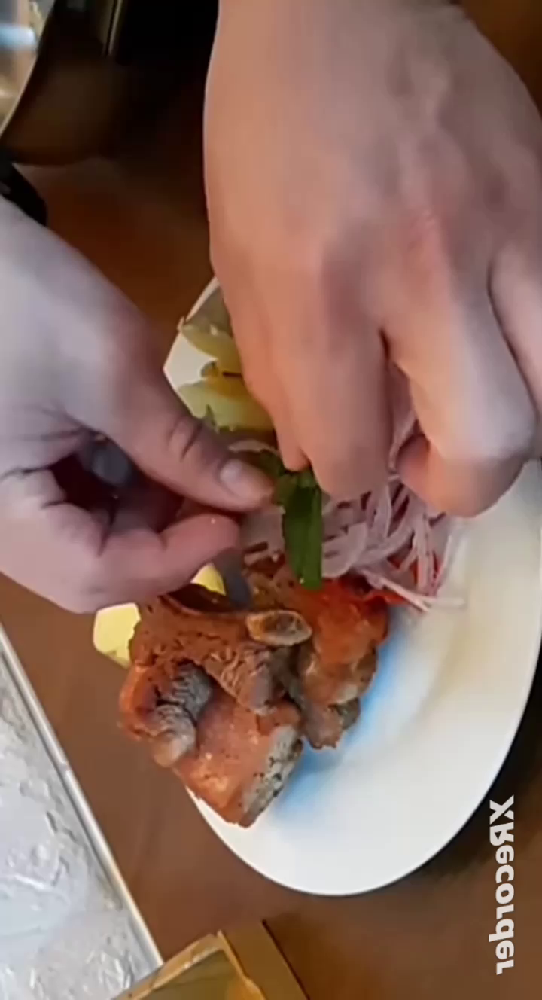

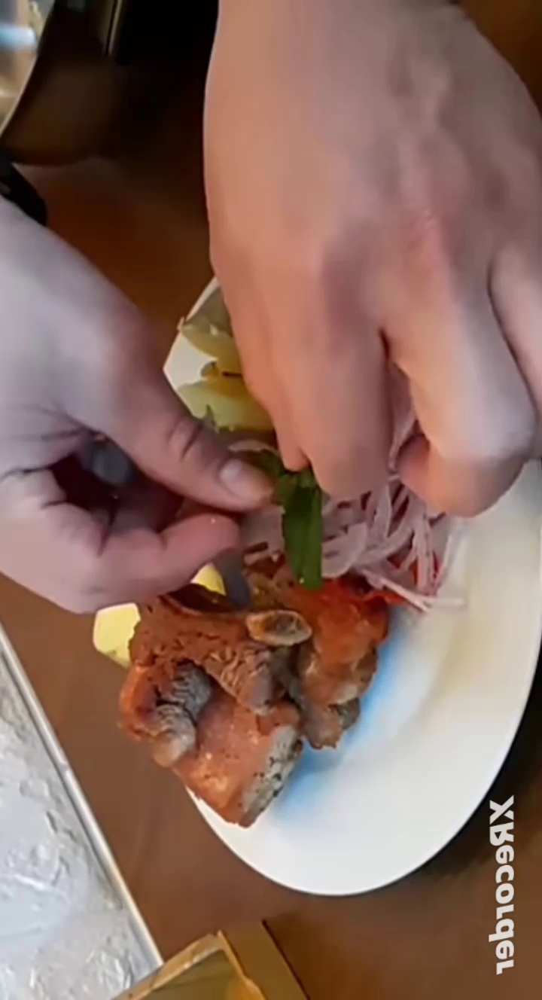

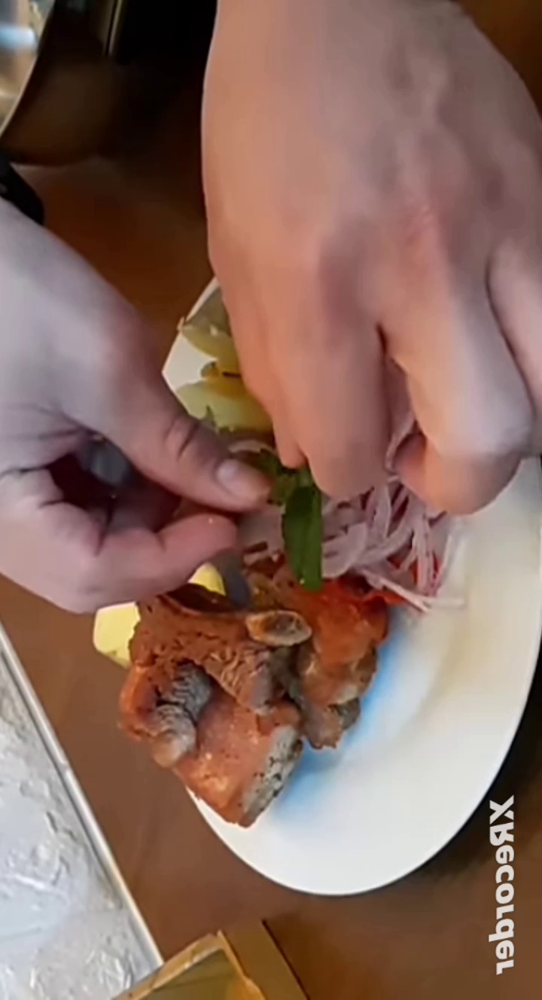

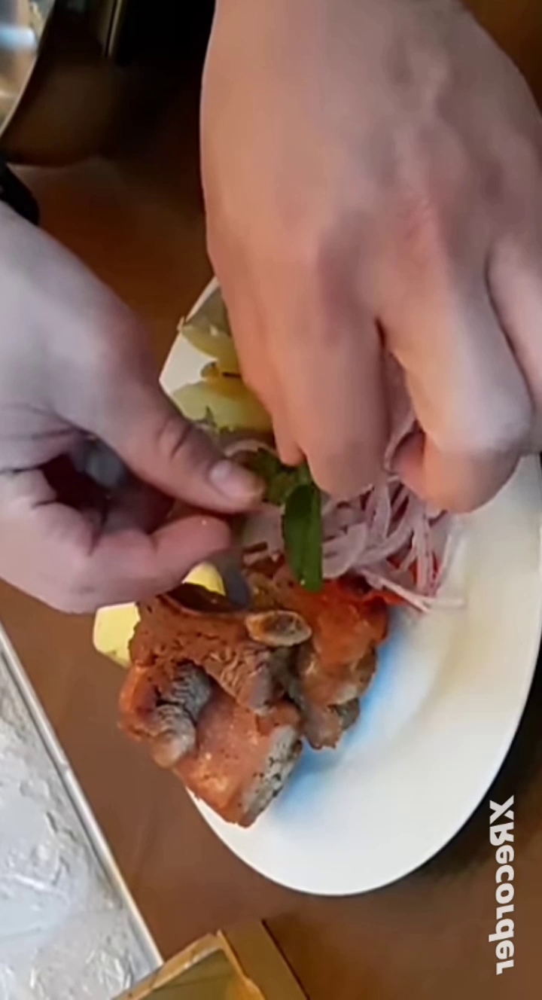

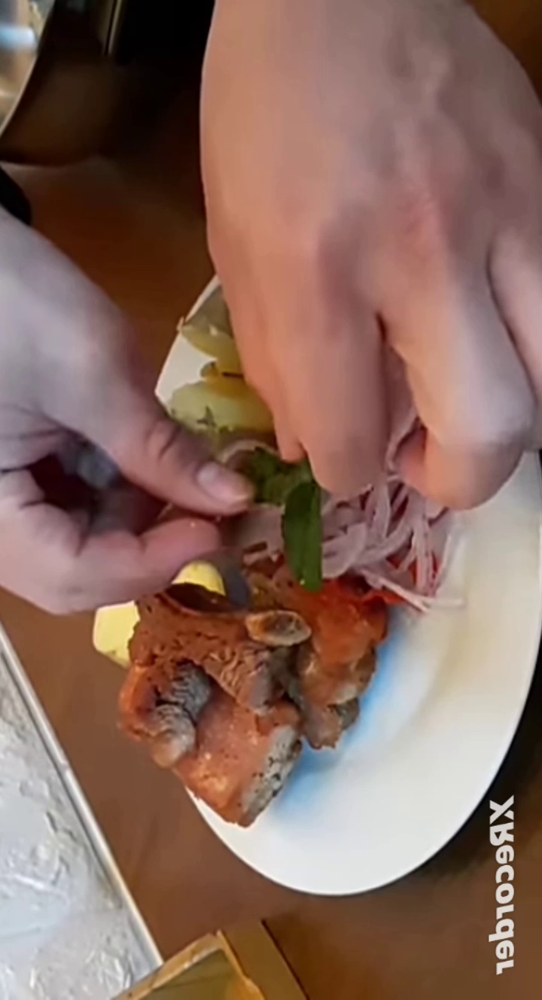

...

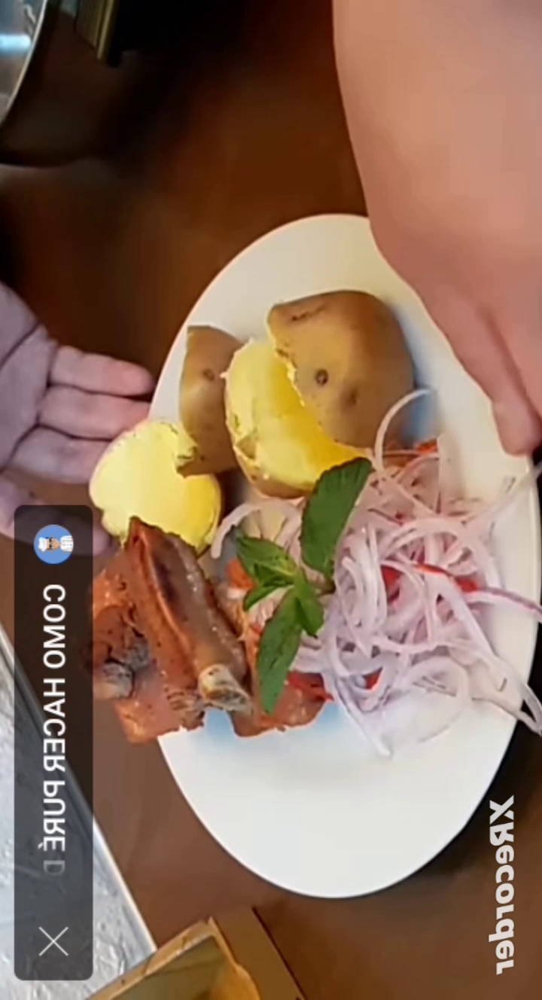

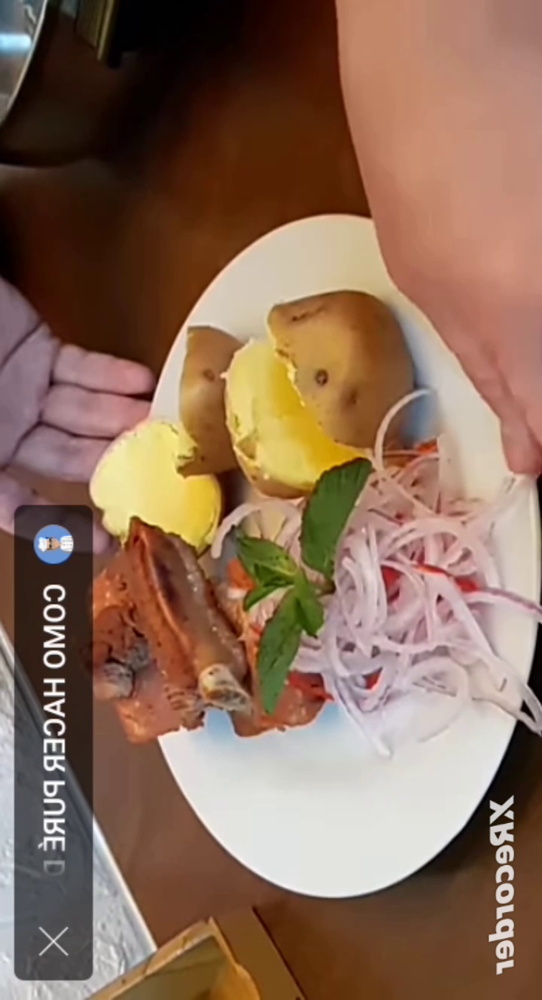

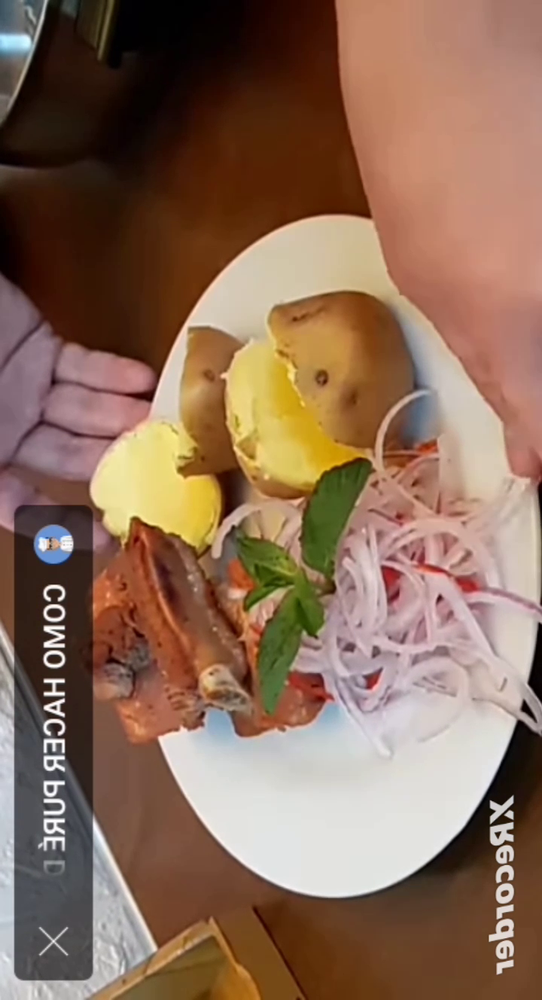

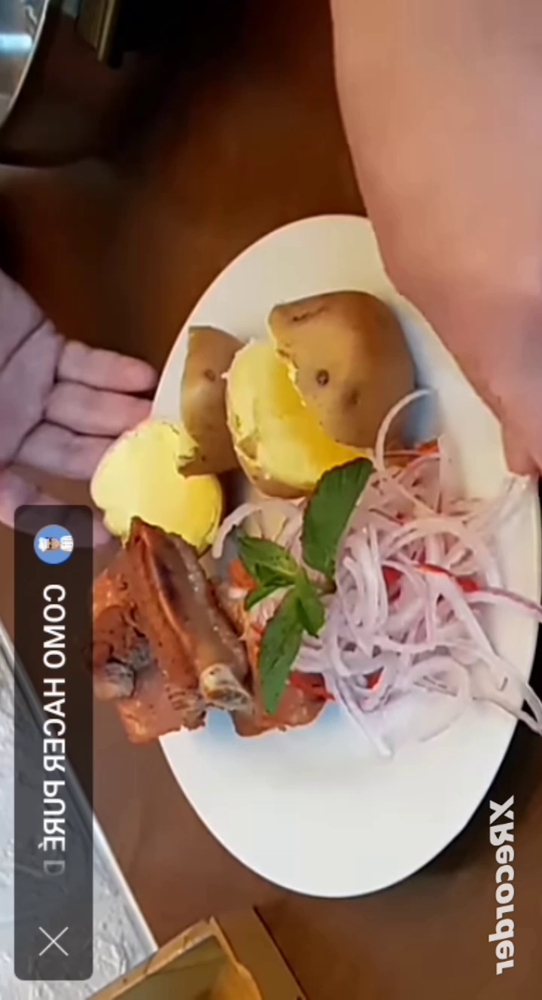

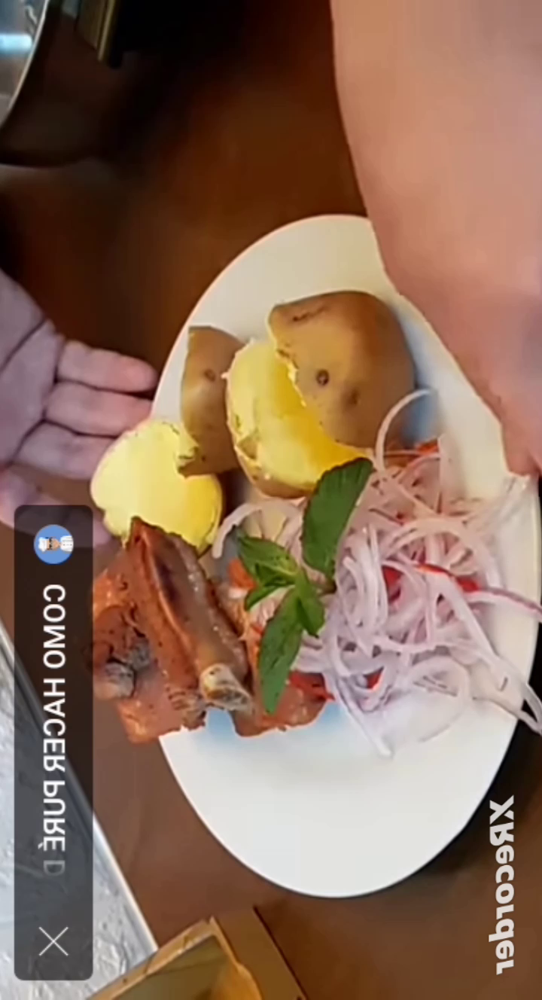

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

def rotate_video(video_path, angle):
    # Abrir el video
    cap = cv2.VideoCapture(video_path)

    # Obtener la información del video (ancho, alto, fps)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Crear un objeto VideoWriter para guardar el video rotado
    out = cv2.VideoWriter('rotated_video.mp4', cv2.VideoWriter_fourcc(*'mp4v'), 25, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Rotar el frame
        rotated_frame = cv2.rotate(frame, cv2.ROTATE_90_CLOCKWISE)

        # Espejar el frame horizontalmente (opcional)
        rotated_frame = cv2.flip(rotated_frame, 1)

        # Mostrar el frame rotado en una ventana
        cv2_imshow(rotated_frame)

        # Escribir el frame rotado en el video de salida
        out.write(rotated_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

# Ruta del video a rotar
video_path = "/content/drive/MyDrive/semaforo/videos/chicharon.mp4"
# Ángulo de rotación (en grados)
angle = 30

# Llamar a la función para rotar el video y mostrar la rotación en tiempo real
rotate_video(video_path, angle)